In [2]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [7]:
!mkdir /content/Data
#!cp /content/drive/MyDrive/setup-002-segmentations.tar.gz /content/Data/
#!tar -xzvf /content/drive/MyDrive/setup-002-segmentations.tar.gz -C /content/Data/
!cp -rv /content/drive/MyDrive/setup_006/* /content/Data/
!cp -v /content/drive/MyDrive/setup-002-standalone.yaml /content/Data/

mkdir: cannot create directory ‘/content/Data’: File exists
'/content/drive/MyDrive/setup_006/20220614_134039.png' -> '/content/Data/20220614_134039.png'
'/content/drive/MyDrive/setup_006/20220614_134040.png' -> '/content/Data/20220614_134040.png'
'/content/drive/MyDrive/setup_006/20220614_134041.png' -> '/content/Data/20220614_134041.png'
'/content/drive/MyDrive/setup_006/20220614_134042.png' -> '/content/Data/20220614_134042.png'
'/content/drive/MyDrive/setup_006/20220614_134043.png' -> '/content/Data/20220614_134043.png'
'/content/drive/MyDrive/setup_006/20220614_134044.png' -> '/content/Data/20220614_134044.png'
'/content/drive/MyDrive/setup_006/20220614_134045.png' -> '/content/Data/20220614_134045.png'
'/content/drive/MyDrive/setup_006/20220614_134046.png' -> '/content/Data/20220614_134046.png'
'/content/drive/MyDrive/setup_006/20220614_134047.png' -> '/content/Data/20220614_134047.png'
'/content/drive/MyDrive/setup_006/20220614_134048.png' -> '/content/Data/20220614_134048.png'


In [ ]:
!cp -v /content/drive/MyDrive/prepare_yolo_data_folders.py /content/
from prepare_yolo_data_folders import prepare_yolo_data_folders
%cd /content/Data
prepare_yolo_data_folders()

In [ ]:
datafromkaggle = False

if datafromkaggle:
    # IMPORTANT: RUN THIS CELL IN ORDER TO IMPORT YOUR KAGGLE DATA SOURCES
    # TO THE CORRECT LOCATION (/kaggle/input) IN YOUR NOTEBOOK,
    # THEN FEEL FREE TO DELETE THIS CELL.
    # NOTE: THIS NOTEBOOK ENVIRONMENT DIFFERS FROM KAGGLE'S PYTHON
    # ENVIRONMENT SO THERE MAY BE MISSING LIBRARIES USED BY YOUR
    # NOTEBOOK.

    import os
    import sys
    from tempfile import NamedTemporaryFile
    from urllib.request import urlopen
    from urllib.parse import unquote, urlparse
    from urllib.error import HTTPError
    from zipfile import ZipFile
    import tarfile
    import shutil

    CHUNK_SIZE = 40960
    DATA_SOURCE_MAPPING = 'setup-002-standalone-yolo:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F5761334%2F9477351%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240925%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240925T093502Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D5c2127ecdb11f7b6b8485e136893ba7b07513f605135802b644d08685c0b8bfd4eea07119d7230c813c339d30c7464d48084895be258980415a07fdbc7427d0c6b0ebd5a300d728ddfc8fc79be8d79a62b0bc3af1b10505634ca9e9ba4797fa226a8787e294259122e6862f1afff93f5504e6e83f20e4249496318f905cf05b231403b1729c08c179f7240c9570852d2d6223a65d17e2cf16af36e74c71211b4219711a1da1f8e473de2f7318df69c1d93c636f8bad5ac6c2fd98663e8592ddd22f510e2334e506456b6235c4b3709f33b74dc80ab2b2e7f8c7645c10041cb78a64f89b2865d3cc5f981888af818dd717455a7e2a242dc41d91907723a9adcb5'
    # Old dataset version:
    #DATA_SOURCE_MAPPING = 'setup-002-standalone-yolo:https%3A%2F%2Fstorage.googleapis.com%2Fkaggle-data-sets%2F5761334%2F9473393%2Fbundle%2Farchive.zip%3FX-Goog-Algorithm%3DGOOG4-RSA-SHA256%26X-Goog-Credential%3Dgcp-kaggle-com%2540kaggle-161607.iam.gserviceaccount.com%252F20240924%252Fauto%252Fstorage%252Fgoog4_request%26X-Goog-Date%3D20240924T195232Z%26X-Goog-Expires%3D259200%26X-Goog-SignedHeaders%3Dhost%26X-Goog-Signature%3D5e6523de5d924639ed617c715145bf5f62b8431198504bdf0d32b3cf1116d7cb909069a2c4838564ff6598cf83aee312a9440bc31cb7bff22262a86a709603ba4daabaed451dbb53f59622158532845c9df1235f8b5bf2d62e603348224a1bb5a41ee889a48f5c29c3ba8a2af18ae868c02c08fd9305873a3927d12fac5dab38c32d861af23f79e9f8cad7530ee74f3b455552ca9e27276f02109dd832a64d58d098b0f0d3ad34cb53bee619b6dd4d10ac5c9a434cb37f9bc7338892ccbdef640f0feaadcf4890a58d8aa8c82b4df5a7aad122c509d0e093e1617ec7e20368cc4acdf25586a0a06af3a4594c4668f896b372108d166397bf69ca7cfa685c94ac'

    KAGGLE_INPUT_PATH='/kaggle/input'
    KAGGLE_WORKING_PATH='/kaggle/working'
    KAGGLE_SYMLINK='kaggle'

    !umount /kaggle/input/ 2> /dev/null
    shutil.rmtree('/kaggle/input', ignore_errors=True)
    os.makedirs(KAGGLE_INPUT_PATH, 0o777, exist_ok=True)
    os.makedirs(KAGGLE_WORKING_PATH, 0o777, exist_ok=True)

    try:
      os.symlink(KAGGLE_INPUT_PATH, os.path.join("..", 'input'), target_is_directory=True)
    except FileExistsError:
      pass
    try:
      os.symlink(KAGGLE_WORKING_PATH, os.path.join("..", 'working'), target_is_directory=True)
    except FileExistsError:
      pass

    for data_source_mapping in DATA_SOURCE_MAPPING.split(','):
        directory, download_url_encoded = data_source_mapping.split(':')
        download_url = unquote(download_url_encoded)
        filename = urlparse(download_url).path
        destination_path = os.path.join(KAGGLE_INPUT_PATH, directory)
        try:
            with urlopen(download_url) as fileres, NamedTemporaryFile() as tfile:
                total_length = fileres.headers['content-length']
                print(f'Downloading {directory}, {total_length} bytes compressed')
                dl = 0
                data = fileres.read(CHUNK_SIZE)
                while len(data) > 0:
                    dl += len(data)
                    tfile.write(data)
                    done = int(50 * dl / int(total_length))
                    sys.stdout.write(f"\r[{'=' * done}{' ' * (50-done)}] {dl} bytes downloaded")
                    sys.stdout.flush()
                    data = fileres.read(CHUNK_SIZE)
                if filename.endswith('.zip'):
                  with ZipFile(tfile) as zfile:
                    zfile.extractall(destination_path)
                else:
                  with tarfile.open(tfile.name) as tarfile:
                    tarfile.extractall(destination_path)
                print(f'\nDownloaded and uncompressed: {directory}')
        except HTTPError as e:
            print(f'Failed to load (likely expired) {download_url} to path {destination_path}')
            continue
        except OSError as e:
            print(f'Failed to load {download_url} to path {destination_path}')
            continue

    print('Data source import complete.')


In [5]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session



## Install ultralytics?

In [6]:
%pip -q install ultralytics
from ultralytics import YOLO

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 874.1/874.1 kB 16.5 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## Loading data and annotations from setup_002 with YOLO annotations:

Note: Download data as "Input" via Kaggle web interface ... for the moment. ;-)

In [ ]:
if datafromkaggle:
    !ls -lh /kaggle/input/setup-002-standalone-yolo/*
    !ls -lh /kaggle/input/setup-002-standalone-yolo/*/*


In [ ]:
!pwd

/content


Okay, so the few images and labels are there. Next: Import YOLO model for training?!
Note: For now, only Bboxes, no segmentations yet!

## Import YOLO model for training

In [8]:
# First try to get tensorboard running:
%load_ext tensorboard

import tensorflow as tf
import datetime

In [9]:
# Load a model
#model = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)
model = YOLO("yolov8m-seg.pt")

100%|██████████| 52.4M/52.4M [00:00<00:00, 243MB/s]


In [ ]:
#!mv /content/prepare_yolo_data_folders.py /content/Data/

NameError: name 'cd' is not defined

In [19]:
%cd /content/Data


/content/Data


In [20]:
!pwd

/content/Data


Current folder is: /content/Data
Found 10 labels.
Found 10 labelled images:
 ['20220614_134225', '20220614_134221', '20220614_134217', '20220614_134228', '20220614_134226', '20220614_134224', '20220614_134223', '20220614_134220', '20220614_134218', '20220614_134215']
Created train/images and train/labels.
Created val/images and val/labels.
Created test/images and test/labels.
Moved 20220614_134225.png to train/images.
Moved converted_segmentation_labels/20220614_134225.txt to train/labels.
Moved 20220614_134221.png to train/images.
Moved converted_segmentation_labels/20220614_134221.txt to train/labels.
Moved 20220614_134217.png to train/images.
Moved converted_segmentation_labels/20220614_134217.txt to train/labels.
Moved 20220614_134228.png to train/images.
Moved converted_segmentation_labels/20220614_134228.txt to train/labels.
Moved 20220614_134226.png to train/images.
Moved converted_segmentation_labels/20220614_134226.txt to train/labels.
Moved 20220614_134224.png to train/images

True

### Train with yaml file from kaggle setup folder

In [ ]:
#!ls /kaggle/input/setup-002-standalone-yolo/val/images

In [23]:
!cat /content/setup-002-standalone.yaml

# 
# Documentation: https://docs.ultralytics.com/datasets/detect/coco8/
# Example usage: yolo train data=coco8.yaml
# parent
# ├── ultralytics
# └── datasets
#     └── coco8  ← downloads here (1 MB)

# Train/val/test sets as 1) dir: path/to/imgs, 2) file: path/to/imgs.txt, or 3) list: [path/to/imgs1, path/to/imgs2, ..]
path: /content/Data # dataset root dir
# TODO: evtl. weitere Ebene einfügen? Weird. 
train: train/images # train images (relative to 'path') 2 images
val: val/images # val images (relative to 'path') 1 image
test: test/images # test images (optional) 1 image

# Classes
names:
  0: cucumber
# 1: bicycle
# 2: car


In [27]:
# Train the model
#trainresults = model.train(data="/content/setup-002-standalone.yaml", epochs=100, imgsz=1280)
trainresults = model.train(data="/content/setup-002-standalone.yaml", epochs=100, imgsz=1280)

Ultralytics YOLOv8.2.101 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=segment, mode=train, model=yolov8m-seg.pt, data=/content/setup-002-standalone.yaml, epochs=100, time=None, patience=100, batch=16, imgsz=1280, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train22, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, sho

train: Scanning /content/Data/train/labels.cache... 7 images, 0 backgrounds, 0 corrupt: 100%|██████████| 7/7 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/Data/val/labels.cache... 2 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2/2 [00:00<?, ?it/s]


Plotting labels to runs/segment/train22/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.002, momentum=0.9) with parameter groups 86 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 1280 train, 1280 val
Using 2 dataloader workers
Logging results to runs/segment/train22
Starting training for 100 epochs...

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      1/100      14.2G      1.089      1.692     0.8605      1.579         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.78it/s]

                   all          2         17          1      0.399      0.604      0.289      0.281      0.115     0.0509    0.00642



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      2/100      13.2G      1.081       1.48       0.86      1.642         68       1280: 100%|██████████| 1/1 [00:01<00:00,  1.40s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.60it/s]

                   all          2         17      0.952      0.412      0.605      0.288      0.274      0.118     0.0507    0.00639



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      3/100      13.8G      1.146      1.619     0.8492      1.677         73       1280: 100%|██████████| 1/1 [00:01<00:00,  1.63s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.13it/s]

                   all          2         17      0.497      0.757      0.626      0.277     0.0398      0.118    0.00888    0.00152



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      4/100      13.7G      1.046        1.5     0.8036       1.64         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


                   all          2         17      0.537      0.529        0.6      0.274      0.045      0.118     0.0111     0.0016

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      5/100      13.8G      1.068      1.648     0.8145      1.592         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.56it/s]

                   all          2         17      0.811      0.471      0.644      0.317     0.0589      0.118     0.0141    0.00228



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      6/100      13.7G      1.077      1.606     0.8205      1.606         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.92it/s]

                   all          2         17      0.968      0.529       0.72      0.338      0.109     0.0588     0.0136    0.00239



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      7/100      13.6G       1.22       1.75     0.9203      1.752         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.31it/s]


                   all          2         17      0.632      0.588      0.628      0.318      0.127     0.0588     0.0165    0.00306

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      8/100      13.7G      1.152      1.614     0.8441      1.623         71       1280: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.65it/s]

                   all          2         17      0.664      0.581      0.625      0.318      0.129     0.0588     0.0157    0.00301



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


      9/100      13.7G      1.139      1.492     0.8257      1.669         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.88it/s]

                   all          2         17       0.82      0.588      0.727      0.382      0.179     0.0588     0.0248    0.00441



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     10/100      13.8G      1.037      1.587     0.8078      1.602         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.77it/s]


                   all          2         17       0.79      0.588      0.758      0.383     0.0695      0.118     0.0186    0.00438

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     11/100      13.9G      1.217      1.611     0.8657      1.753         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.54it/s]

                   all          2         17      0.542      0.588      0.643      0.317     0.0534     0.0588     0.0108    0.00363



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     12/100      13.8G      1.112      1.605      0.932      1.693         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all          2         17      0.604      0.706      0.761      0.359     0.0425      0.176     0.0137    0.00262



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     13/100      13.7G       1.22       1.66       0.95      1.708         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.26it/s]

                   all          2         17      0.859      0.588      0.715      0.348     0.0343      0.118    0.00617    0.00186



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     14/100      13.6G      1.337      1.554          1       1.82         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.65it/s]


                   all          2         17      0.917      0.647      0.739       0.34     0.0189      0.118    0.00557    0.00152

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     15/100      13.8G      1.569      1.593      1.099      1.958         73       1280: 100%|██████████| 1/1 [00:01<00:00,  1.30s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.82it/s]

                   all          2         17      0.899      0.647      0.741       0.34     0.0183      0.118    0.00568    0.00155



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     16/100      13.7G      1.114      1.581     0.8684       1.66         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.03it/s]


                   all          2         17      0.864      0.706       0.73      0.305     0.0471      0.118     0.0138    0.00262

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     17/100      13.7G      1.184      1.511     0.8631      1.639         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.57it/s]


                   all          2         17      0.747      0.706      0.702      0.282     0.0849      0.118     0.0203     0.0036

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     18/100      13.8G      1.092      1.612     0.8865      1.672         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.59it/s]

                   all          2         17      0.747      0.706      0.702      0.282     0.0849      0.118     0.0203     0.0036



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     19/100      13.7G      1.266      1.754     0.9192       1.79         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.25it/s]

                   all          2         17      0.785      0.588      0.673      0.321      0.045      0.118     0.0133    0.00331



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     20/100      13.8G      1.241      1.659     0.8799      1.747         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


                   all          2         17      0.785      0.588      0.673      0.321      0.045      0.118     0.0133    0.00331

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     21/100      13.6G      1.303      1.494     0.9274      1.858         66       1280: 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.49it/s]


                   all          2         17      0.751      0.588      0.636      0.318      0.113      0.176     0.0289    0.00725

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     22/100      13.8G      1.388      1.531      1.046      1.813         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.42it/s]

                   all          2         17      0.751      0.588      0.636      0.318      0.113      0.176     0.0289    0.00725



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     23/100      13.7G      1.196      1.581     0.8124      1.783         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.35s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all          2         17      0.804      0.529      0.681        0.3     0.0774      0.176       0.02    0.00424



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     24/100      13.7G      1.248      1.647     0.8677      1.661         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.16it/s]

                   all          2         17      0.804      0.529      0.681        0.3     0.0774      0.176       0.02    0.00424



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     25/100      13.7G      1.166      1.571     0.8647      1.663         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.22it/s]


                   all          2         17      0.524      0.824      0.674        0.3     0.0981      0.176     0.0211    0.00414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     26/100      13.9G      1.118      1.493     0.8097      1.701         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.52it/s]


                   all          2         17      0.524      0.824      0.674        0.3     0.0981      0.176     0.0211    0.00414

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     27/100      13.6G      1.485      1.549      1.041      1.812         76       1280: 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.56it/s]

                   all          2         17      0.573      0.529       0.57      0.292     0.0561      0.176     0.0126    0.00224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     28/100      13.9G      1.454      1.547     0.9807      1.749         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.82it/s]

                   all          2         17      0.573      0.529       0.57      0.292     0.0561      0.176     0.0126    0.00224



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     29/100      13.6G      1.197      1.515     0.8324      1.718         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.59it/s]

                   all          2         17      0.655      0.529      0.555      0.274     0.0642      0.176      0.014    0.00248



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     30/100      13.9G      1.063      1.474     0.8079      1.662         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.46it/s]


                   all          2         17      0.655      0.529      0.555      0.274     0.0642      0.176      0.014    0.00248

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     31/100      13.6G      1.338      1.615     0.9953       1.75         71       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.85it/s]

                   all          2         17      0.751      0.471      0.645      0.308     0.0244      0.118    0.00657    0.00158



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     32/100      13.7G      1.032      1.419     0.7806      1.599         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.49it/s]

                   all          2         17      0.751      0.471      0.645      0.308     0.0244      0.118    0.00657    0.00158



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     33/100      13.7G      1.183      1.426     0.8554       1.59         68       1280: 100%|██████████| 1/1 [00:01<00:00,  1.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.64it/s]

                   all          2         17      0.511      0.824      0.654       0.31     0.0433     0.0588    0.00814    0.00232



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     34/100      13.7G      1.082      1.785      0.854      1.585         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.92it/s]

                   all          2         17      0.511      0.824      0.654       0.31     0.0433     0.0588    0.00814    0.00232



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     35/100      13.6G      1.201      1.436     0.8952      1.748         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.74it/s]


                   all          2         17       0.54      0.759      0.665      0.294     0.0304     0.0588    0.00455    0.00142

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     36/100      13.7G      1.131      1.563     0.8144      1.575         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.95it/s]

                   all          2         17       0.54      0.759      0.665      0.294     0.0304     0.0588    0.00455    0.00142



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     37/100      13.6G      1.181      1.512     0.8274      1.641         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.34s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.95it/s]

                   all          2         17      0.696      0.765      0.756      0.323    0.00167     0.0588     0.0011   0.000441



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     38/100      13.7G      1.145      1.566     0.7787      1.678         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.64it/s]

                   all          2         17      0.696      0.765      0.756      0.323    0.00167     0.0588     0.0011   0.000441



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     39/100      13.6G        1.2      1.547      0.925      1.728         66       1280: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.09it/s]

                   all          2         17      0.636      0.824      0.758       0.31    0.00647     0.0588    0.00271   0.000468



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     40/100      13.7G       1.16      1.559     0.8618      1.682         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.31it/s]


                   all          2         17      0.636      0.824      0.758       0.31    0.00647     0.0588    0.00271   0.000468

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     41/100      13.6G      1.121      1.379     0.7883      1.699         71       1280: 100%|██████████| 1/1 [00:01<00:00,  1.53s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  1.62it/s]

                   all          2         17      0.665        0.7      0.746      0.287     0.0543     0.0588    0.00599    0.00167



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     42/100      13.6G      1.123      1.719     0.8726      1.621         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.52it/s]

                   all          2         17      0.665        0.7      0.746      0.287     0.0543     0.0588    0.00599    0.00167



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     43/100      13.6G      1.107      1.429     0.8217       1.65         69       1280: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.65it/s]


                   all          2         17      0.774      0.588      0.761      0.309     0.0738     0.0588    0.00724    0.00258

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     44/100      13.8G      1.052      1.365      0.837      1.605         67       1280: 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.93it/s]

                   all          2         17      0.774      0.588      0.761      0.309     0.0738     0.0588    0.00724    0.00258



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     45/100      13.7G      1.134      1.407      0.827      1.636         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.82it/s]

                   all          2         17      0.662      0.588      0.622      0.272     0.0476     0.0588    0.00732     0.0026



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     46/100      13.7G      1.286      1.363      0.878      1.722         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.08it/s]


                   all          2         17      0.662      0.588      0.622      0.272     0.0476     0.0588    0.00732     0.0026

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     47/100      13.6G      1.092      1.426     0.7817      1.691         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.37it/s]


                   all          2         17      0.493      0.588      0.452      0.183     0.0633     0.0588     0.0102    0.00215

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     48/100      13.7G      1.029       1.35     0.7579      1.539         71       1280: 100%|██████████| 1/1 [00:01<00:00,  1.14s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.43it/s]


                   all          2         17      0.493      0.588      0.452      0.183     0.0633     0.0588     0.0102    0.00215

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     49/100      13.6G      1.121      1.579     0.8045      1.716         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all          2         17      0.523      0.412      0.439      0.206    0.00823     0.0588     0.0042    0.00156



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     50/100      13.6G      1.051      1.564     0.7802      1.558         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.05it/s]

                   all          2         17      0.523      0.412      0.439      0.206    0.00823     0.0588     0.0042    0.00156



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     51/100      13.7G      1.073       1.65     0.8066      1.565         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.50it/s]


                   all          2         17      0.578      0.647      0.585      0.232     0.0189      0.118    0.00781     0.0012

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     52/100      13.7G      1.146      1.475     0.9342      1.677         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.59it/s]

                   all          2         17      0.578      0.647      0.585      0.232     0.0189      0.118    0.00781     0.0012



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     53/100      13.7G      1.091      1.521      0.803      1.622         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.13s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.17it/s]


                   all          2         17      0.578      0.647      0.585      0.232     0.0189      0.118    0.00781     0.0012

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     54/100      13.8G      0.979      1.436     0.8512      1.573         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.10it/s]

                   all          2         17      0.632      0.588      0.558      0.228     0.0246      0.118    0.00977    0.00262



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     55/100      13.9G     0.9784      1.446     0.7336       1.65         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all          2         17      0.632      0.588      0.558      0.228     0.0246      0.118    0.00977    0.00262



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     56/100      13.8G      1.055      1.431     0.7651      1.709         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.85it/s]

                   all          2         17      0.632      0.588      0.558      0.228     0.0246      0.118    0.00977    0.00262



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     57/100      13.7G      1.054      1.515     0.7962      1.596         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.16it/s]


                   all          2         17      0.557      0.741       0.64       0.27     0.0324      0.118    0.00754    0.00204

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     58/100      13.7G      1.204      1.588     0.9581      1.769         66       1280: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.40it/s]

                   all          2         17      0.557      0.741       0.64       0.27     0.0324      0.118    0.00754    0.00204



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     59/100      13.7G     0.9336      1.403     0.7424      1.455         71       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.23it/s]

                   all          2         17      0.557      0.741       0.64       0.27     0.0324      0.118    0.00754    0.00204



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     60/100      13.6G      1.252      1.417     0.8866      1.639         67       1280: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.02it/s]

                   all          2         17       0.61      0.588      0.637      0.277     0.0126     0.0588    0.00436    0.00157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     61/100      13.8G       1.08      1.336     0.7517      1.627         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.16s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.53it/s]

                   all          2         17       0.61      0.588      0.637      0.277     0.0126     0.0588    0.00436    0.00157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     62/100      13.8G     0.9884      1.406     0.7531      1.545         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.20s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all          2         17       0.61      0.588      0.637      0.277     0.0126     0.0588    0.00436    0.00157



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     63/100      13.7G      1.147      1.359     0.8148      1.655         70       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.50it/s]

                   all          2         17      0.869      0.647      0.775      0.322     0.0786     0.0588     0.0088    0.00317



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     64/100      13.7G      1.049      1.411     0.7602       1.58         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.76it/s]

                   all          2         17      0.869      0.647      0.775      0.322     0.0786     0.0588     0.0088    0.00317



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     65/100      13.6G      1.014      1.456     0.7988      1.546         70       1280: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.73it/s]

                   all          2         17      0.869      0.647      0.775      0.322     0.0786     0.0588     0.0088    0.00317



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     66/100      13.8G      1.091      1.619     0.7665      1.547         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.44it/s]


                   all          2         17       0.75      0.705      0.724      0.305     0.0655     0.0588    0.00807    0.00357

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     67/100      13.8G     0.8898      1.338      0.689      1.484         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.21it/s]


                   all          2         17       0.75      0.705      0.724      0.305     0.0655     0.0588    0.00807    0.00357

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     68/100      13.7G      1.087      1.464     0.7641      1.545         76       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.71it/s]

                   all          2         17       0.75      0.705      0.724      0.305     0.0655     0.0588    0.00807    0.00357



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     69/100      13.7G      1.049      1.384     0.8327      1.585         69       1280: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.40it/s]


                   all          2         17      0.589      0.706       0.64      0.277     0.0396     0.0588    0.00477    0.00194

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     70/100      13.9G     0.9425      1.293     0.6951      1.519         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.21s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.27it/s]

                   all          2         17      0.589      0.706       0.64      0.277     0.0396     0.0588    0.00477    0.00194



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     71/100      13.6G      0.912      1.478     0.6862      1.438         69       1280: 100%|██████████| 1/1 [00:01<00:00,  1.26s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.12it/s]

                   all          2         17      0.589      0.706       0.64      0.277     0.0396     0.0588    0.00477    0.00194



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     72/100      13.7G      0.909      1.387     0.6911      1.494         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.55s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.08it/s]


                   all          2         17      0.595      0.647      0.576      0.255      0.101     0.0588    0.00908    0.00309

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     73/100      13.9G     0.8908      1.394      0.715      1.415         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.58it/s]

                   all          2         17      0.595      0.647      0.576      0.255      0.101     0.0588    0.00908    0.00309



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     74/100      13.7G       1.01      1.422     0.6865      1.469         76       1280: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.71it/s]

                   all          2         17      0.595      0.647      0.576      0.255      0.101     0.0588    0.00908    0.00309



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     75/100      13.7G      0.974       1.45     0.6941      1.507         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.37it/s]

                   all          2         17      0.646      0.588      0.582      0.263      0.147     0.0588     0.0152    0.00379



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     76/100      13.7G      1.085      1.379     0.7273       1.55         76       1280: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.33it/s]

                   all          2         17      0.646      0.588      0.582      0.263      0.147     0.0588     0.0152    0.00379



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     77/100      13.7G      1.091      1.368     0.7606      1.601         68       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.23it/s]

                   all          2         17      0.646      0.588      0.582      0.263      0.147     0.0588     0.0152    0.00379



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     78/100      13.7G     0.9004      1.366     0.6262      1.417         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.17s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.56it/s]


                   all          2         17      0.672      0.471      0.494      0.223      0.118     0.0588     0.0109    0.00354

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     79/100      13.7G      1.054      1.249     0.7119      1.549         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.24it/s]

                   all          2         17      0.672      0.471      0.494      0.223      0.118     0.0588     0.0109    0.00354



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     80/100      13.6G      1.218      1.404      0.725      1.637         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.22s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.58it/s]

                   all          2         17      0.672      0.471      0.494      0.223      0.118     0.0588     0.0109    0.00354



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     81/100      13.7G     0.9655      1.488     0.6852      1.487         75       1280: 100%|██████████| 1/1 [00:01<00:00,  1.32s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.82it/s]

                   all          2         17      0.798      0.529      0.633      0.281      0.131      0.118     0.0247    0.00682



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     82/100      13.5G      1.208      1.298     0.7867      1.739         67       1280: 100%|██████████| 1/1 [00:01<00:00,  1.38s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  7.68it/s]


                   all          2         17      0.798      0.529      0.633      0.281      0.131      0.118     0.0247    0.00682

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     83/100      13.6G     0.9777      1.274     0.6622      1.498         73       1280: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.35it/s]

                   all          2         17      0.798      0.529      0.633      0.281      0.131      0.118     0.0247    0.00682



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     84/100      13.6G     0.9243       1.26     0.7207      1.484         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.56it/s]

                   all          2         17      0.825      0.588      0.637      0.303     0.0734      0.118     0.0238    0.00637



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     85/100      13.7G     0.8688      1.318     0.6527      1.433         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  8.60it/s]

                   all          2         17      0.825      0.588      0.637      0.303     0.0734      0.118     0.0238    0.00637



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     86/100      13.7G      1.114      1.411     0.7289      1.554         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.29it/s]


                   all          2         17      0.825      0.588      0.637      0.303     0.0734      0.118     0.0238    0.00637

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     87/100      13.7G      1.012      1.261     0.7307      1.542         66       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.27it/s]

                   all          2         17      0.825      0.588      0.637      0.303     0.0734      0.118     0.0238    0.00637



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     88/100      13.7G     0.9417      1.255     0.6868      1.519         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.05it/s]


                   all          2         17      0.952      0.529      0.634      0.313     0.0653     0.0991      0.016    0.00392

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     89/100      13.9G      0.874      1.239     0.6681      1.462         76       1280: 100%|██████████| 1/1 [00:01<00:00,  1.23s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.46it/s]

                   all          2         17      0.952      0.529      0.634      0.313     0.0653     0.0991      0.016    0.00392



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     90/100      13.7G     0.8214       1.34     0.6335      1.372         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.33it/s]


                   all          2         17      0.952      0.529      0.634      0.313     0.0653     0.0991      0.016    0.00392
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     91/100      13.7G      0.876      1.304     0.6122      1.438         74       1280: 100%|██████████| 1/1 [00:08<00:00,  8.01s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  2.09it/s]

                   all          2         17      0.952      0.529      0.634      0.313     0.0653     0.0991      0.016    0.00392



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     92/100      13.6G      1.106      1.248     0.7203        1.6         66       1280: 100%|██████████| 1/1 [00:01<00:00,  1.19s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.30it/s]

                   all          2         17      0.853      0.588      0.687      0.359     0.0156      0.118    0.00978    0.00383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     93/100      13.8G     0.9259      1.292     0.6693      1.436         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.36s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.71it/s]

                   all          2         17      0.853      0.588      0.687      0.359     0.0156      0.118    0.00978    0.00383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     94/100      13.8G     0.8325      1.252     0.5996       1.43         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  3.65it/s]

                   all          2         17      0.853      0.588      0.687      0.359     0.0156      0.118    0.00978    0.00383



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     95/100      13.8G      0.782      1.161     0.5831      1.334         77       1280: 100%|██████████| 1/1 [00:01<00:00,  1.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  5.55it/s]


                   all          2         17      0.853      0.588      0.687      0.359     0.0156      0.118    0.00978    0.00383

      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     96/100      13.6G      1.165      1.304     0.7424      1.682         69       1280: 100%|██████████| 1/1 [00:01<00:00,  1.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.20it/s]

                   all          2         17       0.98      0.529      0.702      0.353     0.0435     0.0588     0.0123    0.00565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     97/100      13.8G     0.7767      1.159     0.6082       1.38         78       1280: 100%|██████████| 1/1 [00:01<00:00,  1.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.58it/s]

                   all          2         17       0.98      0.529      0.702      0.353     0.0435     0.0588     0.0123    0.00565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     98/100      13.6G     0.8235      1.147     0.6091       1.42         72       1280: 100%|██████████| 1/1 [00:01<00:00,  1.10s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.10it/s]

                   all          2         17       0.98      0.529      0.702      0.353     0.0435     0.0588     0.0123    0.00565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


     99/100      13.8G     0.9601      1.216     0.6692      1.468         70       1280: 100%|██████████| 1/1 [00:01<00:00,  1.18s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.72it/s]

                   all          2         17       0.98      0.529      0.702      0.353     0.0435     0.0588     0.0123    0.00565



      Epoch    GPU_mem   box_loss   seg_loss   cls_loss   dfl_loss  Instances       Size


    100/100      13.8G     0.8272      1.178     0.5829      1.428         74       1280: 100%|██████████| 1/1 [00:01<00:00,  1.33s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  4.07it/s]

                   all          2         17      0.973      0.529      0.684      0.349     0.0409     0.0588     0.0185    0.00633



100 epochs completed in 0.169 hours.
Optimizer stripped from runs/segment/train22/weights/last.pt, 54.9MB
Optimizer stripped from runs/segment/train22/weights/best.pt, 54.9MB

Validating runs/segment/train22/weights/best.pt...
Ultralytics YOLOv8.2.101 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
YOLOv8m-seg summary (fused): 245 layers, 27,222,963 parameters, 0 gradients, 110.0 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Mask(P          R      mAP50  mAP50-95): 100%|██████████| 1/1 [00:00<00:00,  6.08it/s]


                   all          2         17      0.806      0.588      0.764      0.384     0.0695      0.118     0.0186    0.00434
Speed: 1.3ms preprocess, 53.4ms inference, 0.0ms loss, 1.8ms postprocess per image
Results saved to runs/segment/train22


In [28]:
model.save("2024-09-26_setup006_noch_spaeter_200epochs.pt")

## Tensorboard:

In [38]:
# Set the locale to UTF-8 ... seriously?! ;-)
#!export LC_ALL=C.UTF-8
!export LANG=C.UTF-8





NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968

In [39]:
# Show tensorboard:
!tensorboard --logdir /content/runs/detect #path/to/runs

NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968

## Show the predictions?!

In [41]:
#predictresults = model(["image1.jpg", "image2.jpg"])  # return a list of Results objects

# # Run inference on 'bus.jpg' with arguments
# model.predict("bus.jpg", save=True, imgsz=320, conf=0.5)

results = model.predict(["/content/Data/test/images/dsc01843.png",
                          "/content/Data/misc/20220614_134218_Gurkenfoto_2.jpg",
                          "/content/Data/misc/20220614_134218_Gurkenfoto_rescaled_640.jpg"
                         ],
                        imgsz=1280,
                        conf=0.5,
                        #show=True,
                        save=True)

# for result in results:
#   boxes = result.boxes
#   probs = result.probs
#   #result.show()

# # Process result:
# # for result in results:
# boxes = result.boxes  # Boxes object for bounding box outputs
# # masks = result.masks  # Masks object for segmentation masks outputs
# # keypoints = result.keypoints  # Keypoints object for pose outputs
# probs = result.probs  # Probs object for classification outputs
# obb = result.obb  # Oriented boxes object for OBB outputs
# result.show()  # display to screen


0: 1280x1280 4 cucumbers, 67.7ms
1: 1280x1280 4 cucumbers, 67.7ms
2: 1280x1280 7 cucumbers, 67.7ms
Speed: 17.7ms preprocess, 67.7ms inference, 10.1ms postprocess per image at shape (1, 3, 1280, 1280)
Results saved to runs/segment/train243


### Show resulting pictures:

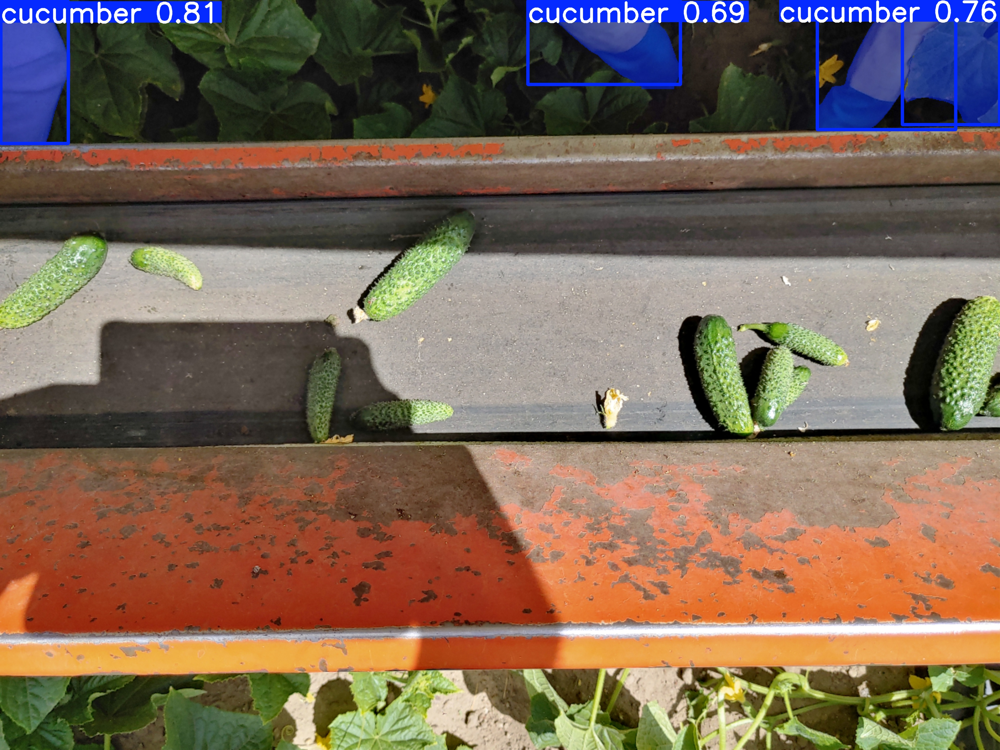

In [42]:
from IPython.display import Image
Image(filename='/content/runs/segment/train243/20220614_134218_Gurkenfoto_2.jpg', width=400)


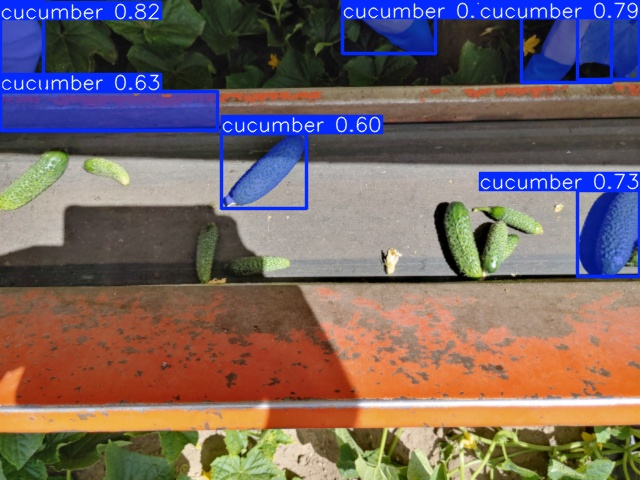

In [ ]:
Image(filename='/content/runs/segment/train242/20220614_134218_Gurkenfoto_rescaled_640.jpg', width=400)


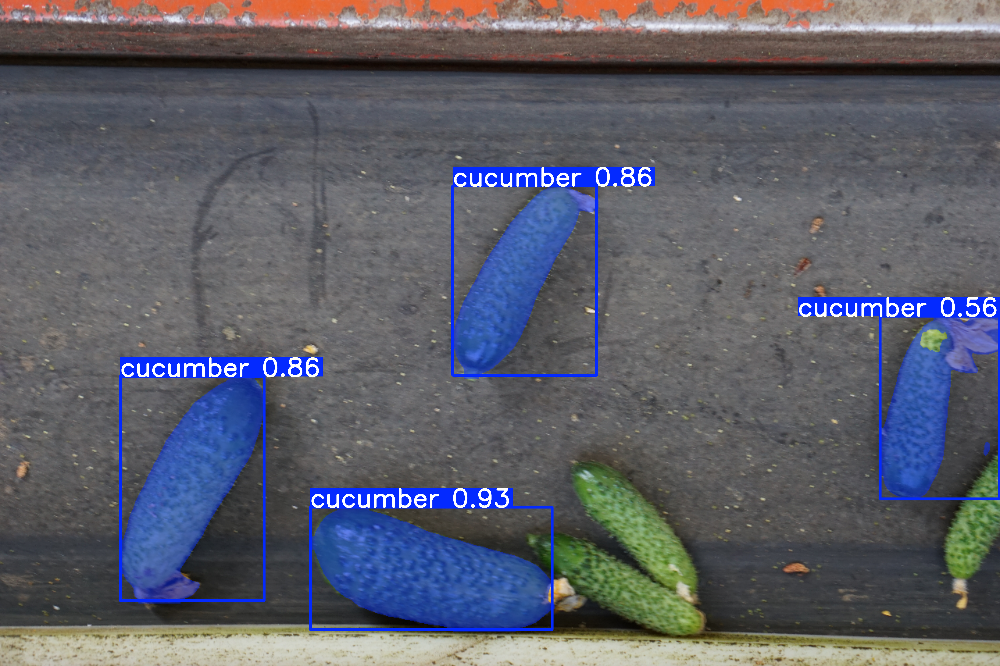

In [ ]:
Image(filename='/content/runs/segment/train242/dsc01843.png', width=400)

## Download the model?

In [43]:
#model.export()

Ultralytics YOLOv8.2.101 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLOv8s-seg summary (fused): 195 layers, 11,779,987 parameters, 0 gradients, 42.4 GFLOPs

PyTorch: starting from 'runs/segment/train24/weights/best.pt' with input shape (1, 3, 1280, 1280) BCHW and output shape(s) ((1, 37, 33600), (1, 32, 320, 320)) (22.8 MB)

TorchScript: starting export with torch 2.4.1+cu121...
TorchScript: export success ✅ 22.9s, saved as 'runs/segment/train24/weights/best.torchscript' (45.7 MB)

Export complete (35.1s)
Results saved to /content/runs/segment/train24/weights
Predict:         yolo predict task=segment model=runs/segment/train24/weights/best.torchscript imgsz=1280  
Validate:        yolo val task=segment model=runs/segment/train24/weights/best.torchscript imgsz=1280 data=/content/Data/misc/setup-002-standalone.yaml  
Visualize:       https://netron.app


'runs/segment/train24/weights/best.torchscript'

In [45]:
model.save("save-test.pt")
